# Prepare environment

In [1]:
# plots and graphs
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import scanpy as sc
import plotly.graph_objects as go
import plotly.express as px

import warnings

warnings.filterwarnings("ignore")

print("Scanpy version: ", sc.__version__)
print("Pandas version: ", pd.__version__)

# interaction with system
import os
import sys

sys.path.append("./../../../../utilities_folder")
from utilities import CleanList, computeGeneScores, plot_box

Scanpy version:  1.9.3
Pandas version:  1.2.4


Set some parameters for the plots:

In [2]:
%matplotlib inline
cell_cycle_palette = dict({"G2M":"#FFB482","S":"#8DE5A1","G1":"#A1C9F4"})
colors = sns.color_palette('pastel')[0:5]

sc.set_figure_params(color_map = 'PuBu', dpi = 600, fontsize = 20)

plt.rcParams['pdf.fonttype'] = 'truetype'


In [3]:
meiosis_folder = './../../../../data/'
cc_folder = './../../../../cellcycle_folder/'

# Load adata

In [4]:
adata = sc.read("1_All_Annotated_Triku.h5ad")
adata

AnnData object with n_obs × n_vars = 27925 × 14582
    obs: 'sample_id', 'run_id', 'probe_barcode_ids', 'subject', 'line', 'specimen', 'stage', 'condition', 'notes', 'seqRun', 'original_name', 'project', 'who', 'SC_derivation', 'micoplasma', 'mosaic', 'genSite', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'gene_UMI_ratio', 'log1p_gene_UMI_ratio', 'scDblFinder_score', 'scDblFinder_class', 'n_counts', 'n_genes', 'leiden', 'score_pluripotency', 'score_mesoderm', 'score_PS', 'score_EM', 'score_AM', 'score_Endo', 'score_Epi', 'score_HEP', 'score_NM', 'score_ExM', 'score_Ery', 'score_EAE', 'score_Amnion_LC', 'score_AxM', 'score_Amnion', 'score_NNE', 'score_PGC', 'score_hPGCLCs', 'score_DE1', 'score_DE2', 'score_Hypoblast', 'score_YS', 'score_EMPs', 'score_Endothelium', 'score_Myeloid_Progenitors', 'score_Megakaryocyte_

# Cell Cycle score computation

In [5]:
cell_cycle_path = cc_folder + 'regev_lab_cell_cycle_genes_2021-10-21.txt'

In [6]:
cell_cycle_genes = [x.strip() for x in open(cell_cycle_path)]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]
len(cell_cycle_genes)

97

In [7]:
s_genes = cell_cycle_genes[:43]
g2m_genes= cell_cycle_genes[43:]

In [8]:
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

In [9]:
adata_cc_genes = adata[:, cell_cycle_genes]
adata_cc_genes

View of AnnData object with n_obs × n_vars = 27925 × 97
    obs: 'sample_id', 'run_id', 'probe_barcode_ids', 'subject', 'line', 'specimen', 'stage', 'condition', 'notes', 'seqRun', 'original_name', 'project', 'who', 'SC_derivation', 'micoplasma', 'mosaic', 'genSite', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'gene_UMI_ratio', 'log1p_gene_UMI_ratio', 'scDblFinder_score', 'scDblFinder_class', 'n_counts', 'n_genes', 'leiden', 'score_pluripotency', 'score_mesoderm', 'score_PS', 'score_EM', 'score_AM', 'score_Endo', 'score_Epi', 'score_HEP', 'score_NM', 'score_ExM', 'score_Ery', 'score_EAE', 'score_Amnion_LC', 'score_AxM', 'score_Amnion', 'score_NNE', 'score_PGC', 'score_hPGCLCs', 'score_DE1', 'score_DE2', 'score_Hypoblast', 'score_YS', 'score_EMPs', 'score_Endothelium', 'score_Myeloid_Progenitors', 'score_Megakaryo

In [10]:
sc.pp.filter_genes(adata_cc_genes, min_counts = 1)
sc.pp.filter_cells(adata_cc_genes, min_counts = 1)

In [11]:
adata_cc_genes

AnnData object with n_obs × n_vars = 27925 × 97
    obs: 'sample_id', 'run_id', 'probe_barcode_ids', 'subject', 'line', 'specimen', 'stage', 'condition', 'notes', 'seqRun', 'original_name', 'project', 'who', 'SC_derivation', 'micoplasma', 'mosaic', 'genSite', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'gene_UMI_ratio', 'log1p_gene_UMI_ratio', 'scDblFinder_score', 'scDblFinder_class', 'n_counts', 'n_genes', 'leiden', 'score_pluripotency', 'score_mesoderm', 'score_PS', 'score_EM', 'score_AM', 'score_Endo', 'score_Epi', 'score_HEP', 'score_NM', 'score_ExM', 'score_Ery', 'score_EAE', 'score_Amnion_LC', 'score_AxM', 'score_Amnion', 'score_NNE', 'score_PGC', 'score_hPGCLCs', 'score_DE1', 'score_DE2', 'score_Hypoblast', 'score_YS', 'score_EMPs', 'score_Endothelium', 'score_Myeloid_Progenitors', 'score_Megakaryocyte_Ery

In [12]:
pca = sc.tl.pca(adata_cc_genes.X.todense())

In [13]:
adata_cc_genes.obsm["X_pca"] = pca

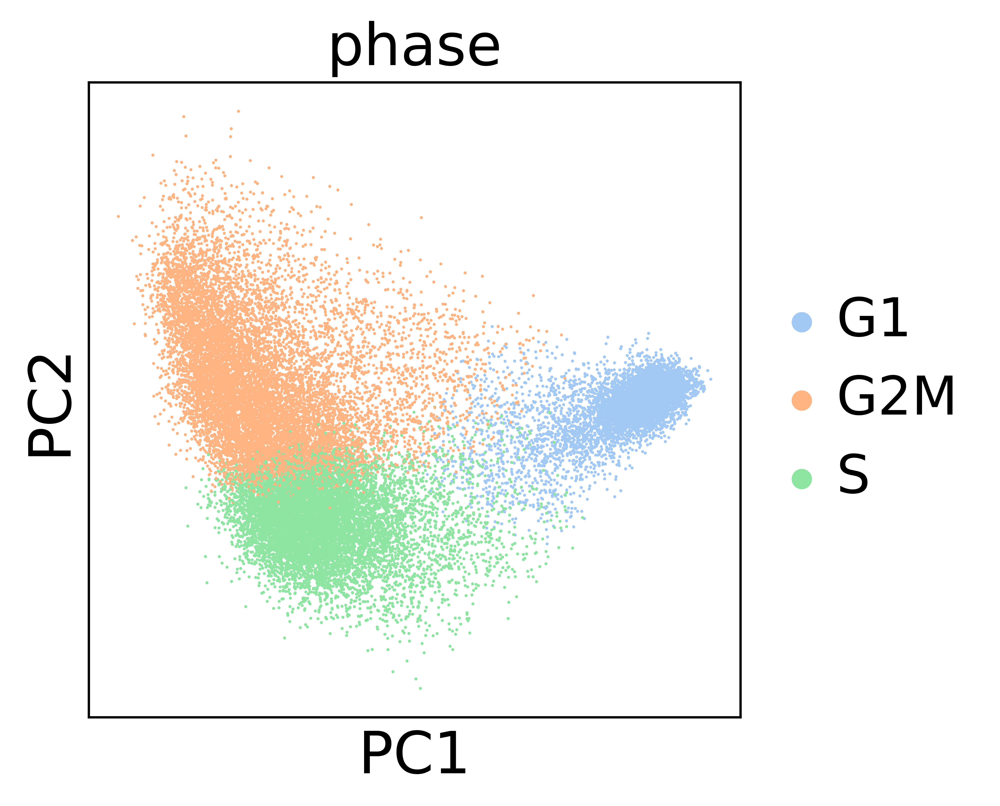

In [14]:
sc.pl.pca_scatter(adata_cc_genes, color='phase', palette = cell_cycle_palette)

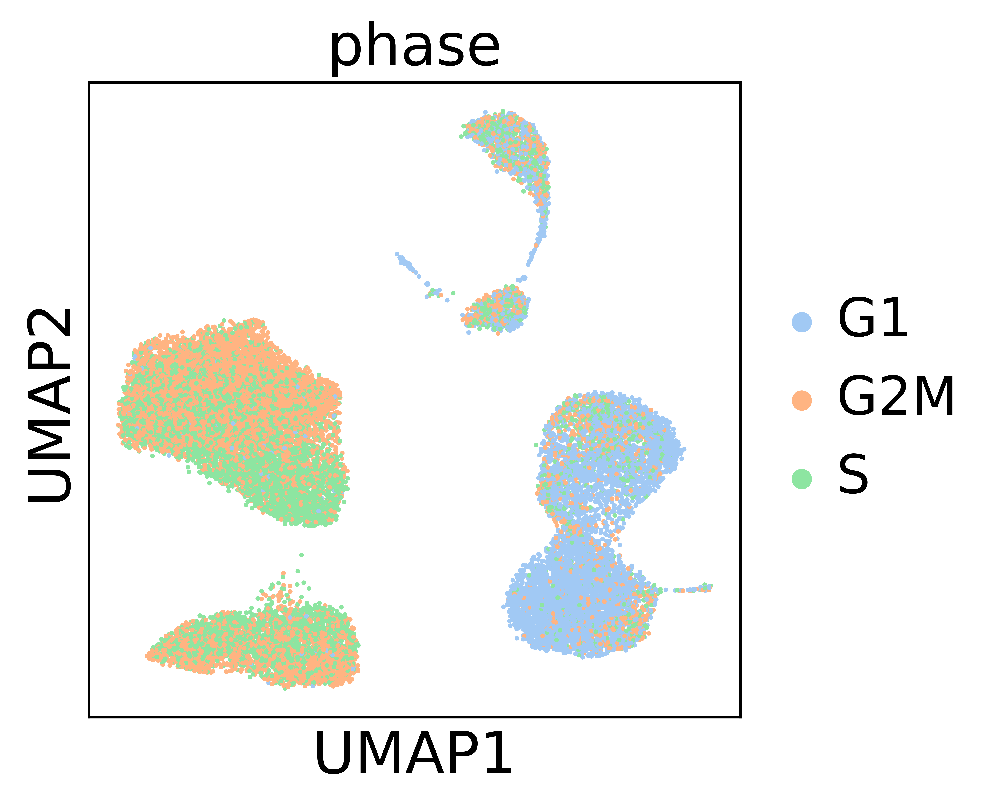

In [15]:
sc.pl.umap(adata, color = ['phase'], palette = cell_cycle_palette, s = 10)
sc.pl.umap(adata, color = ['leiden', "CellTypes"])

## Cell cycle phases in clusters

In [16]:
tot_cc_percentages = {}
fig, ax = plt.subplots(1, 4, figsize = (30, 15))
plt.rc('font', size=20)

speciments = ["hiPSC", "iMeLC", "hPGCLC aggregate", "hEGCLC"]
i = 0

for key in speciments:
    tot_cc_percentages[key] = (adata[adata.obs.specimen == key].obs['phase'].value_counts() / adata.obs.specimen.value_counts()[key]) * 100
    tot_cc_percentages[key] = tot_cc_percentages[key][tot_cc_percentages[key].index.sort_values()]
    data = tot_cc_percentages[key].values
    labels = tot_cc_percentages[key].index
    
    ax[i].pie(data, labels = labels, colors = [cell_cycle_palette[i] for i in labels], autopct='%.0f%%')
    ax[i].set_title(key, fontsize = 20)
    i += 1

plt.show()

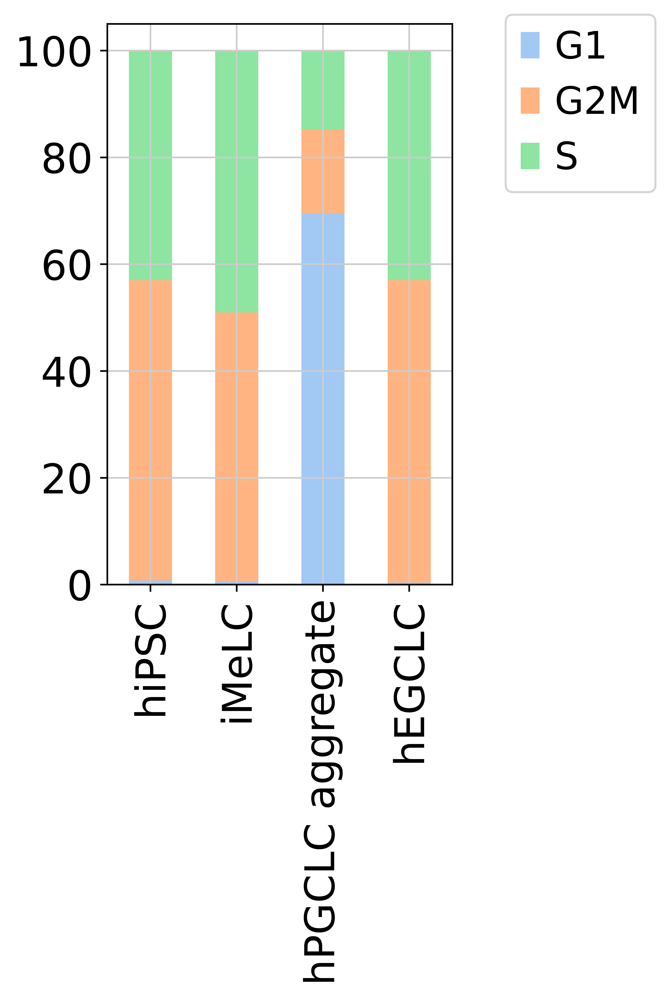

In [17]:
data = pd.DataFrame(tot_cc_percentages).T

data.plot(kind = 'bar', stacked = True, color = cell_cycle_palette, figsize=(3, 5))

plt.legend(bbox_to_anchor=(1.1, 1.05))

In [18]:
celltype_cc_percentages = {}
fig, ax = plt.subplots(2, 4, figsize = (30, 20))
plt.rc('font', size=20)
ax = ax.flatten().T


for key, ax in zip(np.unique(adata.obs.CellTypes), ax):
    celltype_cc_percentages[key] = (adata[adata.obs.CellTypes == key].obs['phase'].value_counts() / adata.obs.CellTypes.value_counts()[key]) * 100
    celltype_cc_percentages[key] = celltype_cc_percentages[key][celltype_cc_percentages[key].index.sort_values()]
    data = celltype_cc_percentages[key].values
    labels = celltype_cc_percentages[key].index
    
    ax.pie(data, labels = labels, colors = [cell_cycle_palette[i] for i in labels], autopct='%.0f%%')
    ax.set_title(key, fontsize = 20)

plt.show()

In [19]:
celltype_cc_percentages = {}
fig, ax = plt.subplots(2, 4, figsize = (30, 20))
plt.rc('font', size=20)
ax = ax.flatten().T


for key, ax in zip(np.unique(adata.obs["leiden"]), ax):
    celltype_cc_percentages[key] = (adata[adata.obs["leiden"] == key].obs['phase'].value_counts() / adata.obs["leiden"].value_counts()[key]) * 100
    celltype_cc_percentages[key] = celltype_cc_percentages[key][celltype_cc_percentages[key].index.sort_values()]
    data = celltype_cc_percentages[key].values
    labels = celltype_cc_percentages[key].index
    
    ax.pie(data, labels = labels, colors = [cell_cycle_palette[i] for i in labels], autopct='%.0f%%')
    ax.set_title(key, fontsize = 20)

plt.show()

# Mitosis and meiosis

List found in [The Transcriptome and DNA Methylome Landscapes of Human Primordial Germ Cells](https://pubmed.ncbi.nlm.nih.gov/26046443/)

In [20]:
meiosis_genes_path = meiosis_folder + '/meiotic_genes.txt'
meiosis_genes = [x.strip() for x in open(meiosis_genes_path)]
meiosis_genes = [x for x in meiosis_genes if x in adata.var_names]
len(meiosis_genes)

86

In [21]:
# sc.pl.umap(adata, color = meiosis_genes, vmin = 'p1', vmax = 'p99')

In [22]:
plot_box(
    adata,
    CleanList(meiosis_genes[0:12], adata),
    "CellTypes",
    order = ['hiPSC', 'iMeLC', 'MLC', 'hPGCLC', 'hEGCLC'],
    ncols=3,
)
plt.show()

In [23]:
meiosis_specific = ['SYCE3', 'SYCE2', 'SYCE1L']
sc.pl.umap(adata, color = meiosis_specific, vmin = 'p1', vmax = 'p99')

# Save

In [24]:
adata.write("./2_All_WithCellCycle.h5ad")